In [55]:
import cv2
import matplotlib.pyplot as plt
import deepdish as dd
import numpy as np
import random
import time
import math

data = dd.io.load("dataset/fabric_pose_class_0405.h5")

X, Y = data["X"], data["Y"]
X, Y = np.array(X), np.array(Y)
X.shape

# Y[:,2] /= 90.

(28000, 2, 90, 120, 3)

In [3]:
from util.reconstruction import Class_3D
from util.reconstruction import demark
from util import helper

# sensor_id = "W00"
sensor_id = "Fabric"
model_id = "RGB"
model_fn = f"models/LUT_{sensor_id}_{model_id}.pkl"
c3d = Class_3D(model_fn=model_fn, features_type=model_id)

In [3]:
print("X_max", X.max(), "X_min", X.min())

X_max 0.9269195 X_min -0.12399125


In [61]:
idx = list(range(X.shape[0]))
random.shuffle(idx)
X, Y = X[idx], Y[idx]
Y_theta = np.hstack([
    Y[:, :2], 
#     Y[:, [0]] - Y[:, [1]]*np.tan(Y[:, [2]]/ 180. * np.pi),
    np.sin(Y[:, [2]]  / 180. * np.pi),
    np.cos(Y[:,[2]] / 180. * np.pi),
    Y[:, [-1]]          
])

# Y_theta = np.hstack([Y, np.cos(Y[:,[2]] / 180. * np.pi)])
# Y_theta[:, 2] = np.sin(Y_theta[:, 2] / 180. * np.pi)

N = int(X.shape[0] * 0.8)
X_train, Y_train = X[:N, 1], Y_theta[:N]
X_test, Y_test = X[N:, 1], Y_theta[N:]

In [30]:
X_test.shape

(5600, 90, 120, 3)

In [62]:
import torch
import torch.nn as nn
import torch.nn.functional as F


class Net(nn.Module):
    def __init__(self):
        super(Net, self).__init__()
        self.conv1 = nn.Conv2d(3, 6, 5)
        self.conv2 = nn.Conv2d(6, 16, 5)
        self.conv3 = nn.Conv2d(16, 32, 5)
#         self.conv4 = nn.Conv2d(32, 128, 5)
        self.pool = nn.MaxPool2d(2, 2)
        self.fc1 = nn.Linear(32 * 7 * 11, 512)
#         self.fc1 = nn.Linear(128 * 1 * 3, 120)
        self.fc2 = nn.Linear(512, 128)
        self.fc3 = nn.Linear(128, 8)

    def forward(self, x):
        x = x.permute(0, 3, 1, 2)
        x = torch.tanh(self.conv1(x))
        x = self.pool(x)
        x = torch.tanh(self.conv2(x))
        x = self.pool(x)
        x = torch.tanh(self.conv3(x))
        x = self.pool(x)
#         x = self.pool(torch.tanh(self.conv4(x)))
#         x = x.permute(0, 2, 3, 1)
#         print(x.size())
        x = x.reshape(-1, 32 * 7 * 11)
        x = F.leaky_relu(self.fc1(x))
        x = F.leaky_relu(self.fc2(x))
#         x = F.relu(self.fc1(x))
#         x = F.relu(self.fc2(x))
        x = self.fc3(x)
        return x

    def fit(self, X_train, Y_train, device, lrate=0.01, num_iters=100):
        batch_size = 32
        N = X_train.shape[0]


        optim = torch.optim.Adam(self.parameters(), lr=lrate)
        sum_loss = 0
        total = 0
        
        for epoch in range(num_iters):
            
#             sum_loss = 0
#             total = 0
        
            
            if epoch % 5 == 0:
                idx = list(range(N))
                random.shuffle(idx)

                X_train = X_train[idx]
                Y_train = Y_train[idx]
        
            for i in range(N // batch_size):
                # clear gradients accumulated on the parameters
                optim.zero_grad()
                
                x_np = X_train[i * batch_size : (i + 1) * batch_size].copy()
#                 for img in x_np:
#                     for c in range(3):
#                         img[:,:,c] = np.clip(img[:,:,c]*(1.15 - np.random.random() * 0.3), 0, 255)
#                         img[:,:,c] = np.clip(img[:,:,c]*(1.5 - np.random.random() * 1), 0, 255)
                x = torch.tensor(x_np, dtype=torch.float32).to(device)

                # get an input (say we only care inputs sampled from N(0, I))
                # x = torch.randn(batch_size, 8, device=cuda0)  # this has to be on GPU too
#                 x = torch.tensor(
#                     X_train[i * batch_size : (i + 1) * batch_size], dtype=torch.float32
#                 ).to(device)
                y = torch.tensor(
                    Y_train[i * batch_size : (i + 1) * batch_size], dtype=torch.float32
                ).to(device)

                # forward pass
                result = self.forward(x)  # CHANGED: fc => net

                # compute loss
                loss = 0
                s_sqrt = result[:, 4]
                for j in range(4):
                    m = result[:, j]
                    loss += (((m-y[:, j])**2)*(y[:, 4] == 1)).mean()
#                     loss += (((y[:, j]-m)**2/(2*s_sqrt**4) + (math.sqrt(2*math.pi)*s_sqrt**2).log()) * (y[:, 4] == 1)).mean()*0.5
                criterion = nn.CrossEntropyLoss()   
                loss += criterion(result[:, 5:], y[:, 4].long())*0.01

                # compute gradients
                loss.backward()

                # let the optimizer do its work; the parameters will be updated in this call
                optim.step()

                sum_loss += loss.item()
#                 if i % 100 == 0:
#                     print(loss.item())
                total += 1
                # add some printing
            if (epoch + 1) % 1 == 0:
                print(
                    "epoch {}\titeration {}\tloss {:.8f}".format(
                        epoch, i, sum_loss / total
                    )
                )

    def predict(self, X_test, device):
        with torch.no_grad():
            return self.forward(torch.tensor(X_test, dtype=torch.float32).to(device)).cpu().numpy()


device = torch.device("cuda:0")

# x = torch.tensor(X[:5], dtype=torch.float32).to(device)
# y = net(x)
# print(y.size())

In [63]:
net = Net().to(device)

In [66]:
# net.fit(X_train, Y_train, device, lrate=0.000001)
net.fit(X_train, Y_train, device, lrate=0.000001, num_iters=1000)

epoch 0	iteration 699	loss 0.02191327
epoch 1	iteration 699	loss 0.01921934


KeyboardInterrupt: 

In [30]:
torch.save(net.state_dict(), "models/combined_0422.pth")

In [65]:
net.load_state_dict(torch.load("models/combined_mse_0328.pth", map_location=device))

<All keys matched successfully>

In [ ]:
net.load_state_dict(torch.load("models/combined_0421.pth", map_location=device))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[  0.6226275    0.74498665  -0.70989037   0.75316775  -0.01582973
 -13.276813    11.255125   -10.675144  ] [ 0.5849684   0.61469828 -0.65807762  0.75295009  1.        ]
2.0
tensor([2.6053e-19, 6.1304e-08, 1.0000e+00])
tensor(2)
sigma:  0.0016703151566377361


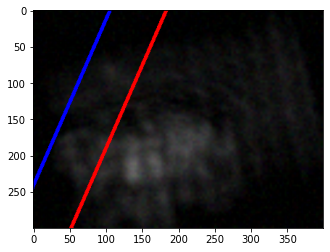

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([3.2662e-16, 4.9000e-08, 1.0000e+00])
tensor(2)
sigma:  0.00010282552887203034


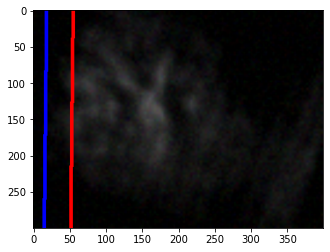

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([2.2632e-11, 1.0000e+00, 3.8443e-08])
tensor(1)
sigma:  0.0002940381639291445


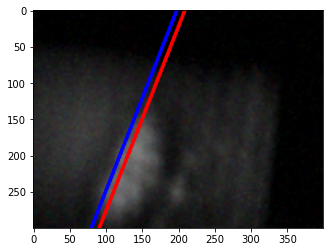

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([3.8441e-16, 1.0817e-05, 9.9999e-01])
tensor(2)
sigma:  3.923084991432069e-05


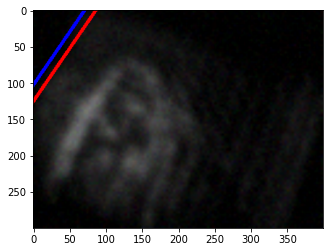

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([2.4367e-12, 9.9929e-01, 7.1415e-04])
tensor(1)
sigma:  0.0010716364063665523


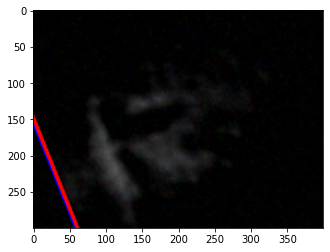

0.0
tensor([1.0000e+00, 1.0194e-20, 6.4840e-18])
tensor(0)
sigma:  0.9162923000678838


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


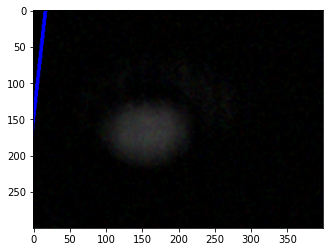

2.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([3.3842e-13, 2.9405e-06, 1.0000e+00])
tensor(2)
sigma:  0.001784251695664596


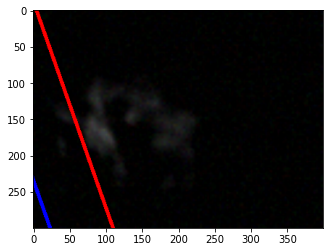

2.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([5.9187e-21, 1.9065e-08, 1.0000e+00])
tensor(2)
sigma:  0.002983037320160309


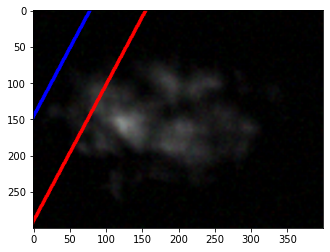

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([5.2656e-13, 1.0000e+00, 1.5463e-07])
tensor(1)
sigma:  0.0003082483404371339


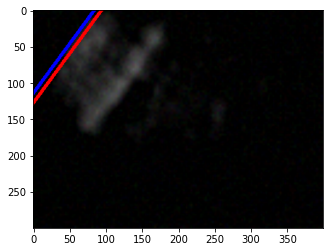

0.0
tensor([1.0000e+00, 2.6246e-21, 5.1270e-18])
tensor(0)
sigma:  0.9882099919751433


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


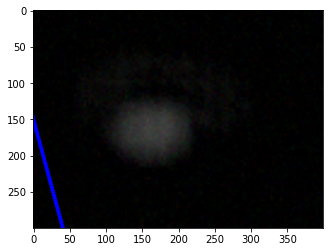

1.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([3.1895e-09, 1.0000e+00, 2.5211e-07])
tensor(1)
sigma:  0.0005141683016685189


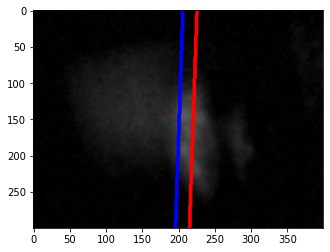

1.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([8.1492e-13, 1.0000e+00, 7.2394e-08])
tensor(1)
sigma:  0.00027654059046172685


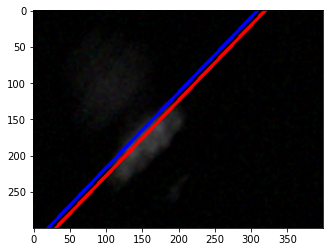

1.0
tensor([6.2025e-10, 1.0000e+00, 1.3629e-07])
tensor(1)
sigma:  0.000652037106058323


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


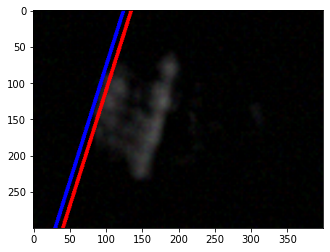

2.0
tensor([4.5178e-17, 1.6420e-07, 1.0000e+00])
tensor(2)
sigma:  0.0002616091137500748


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


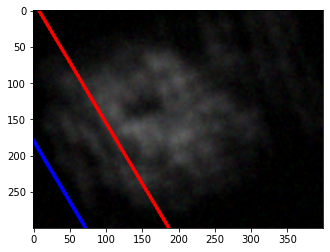

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([2.6552e-18, 1.0967e-09, 1.0000e+00])
tensor(2)
sigma:  0.00022400925239264569


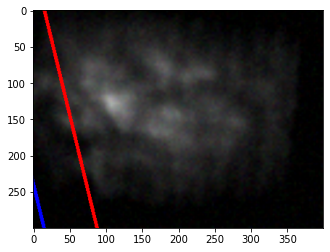

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([1.5520e-08, 1.0000e+00, 2.7380e-07])
tensor(1)
sigma:  0.0034745587195326166


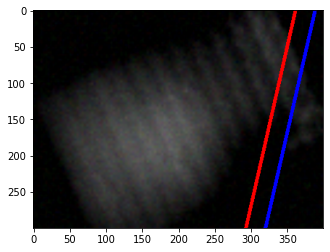

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([5.4239e-15, 3.0225e-07, 1.0000e+00])
tensor(2)
sigma:  0.00036827505885518586


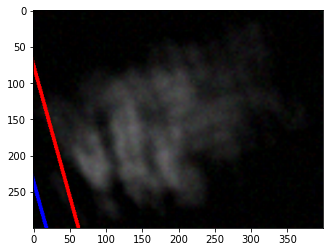

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([2.1335e-14, 1.0000e+00, 5.2099e-07])
tensor(1)
sigma:  0.0020180853040634994


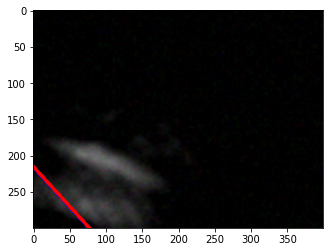

1.0
tensor([1.8646e-12, 9.9990e-01, 9.7604e-05])
tensor(1)
sigma:  0.001676298782354993


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


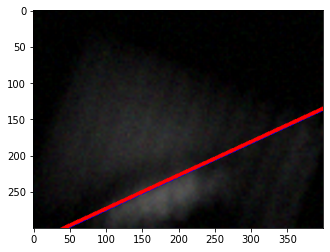

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([5.9751e-19, 2.1031e-08, 1.0000e+00])
tensor(2)
sigma:  0.0033008376831844544


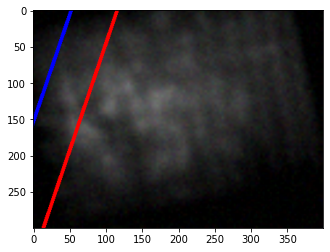

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([7.9898e-09, 1.0000e+00, 1.3018e-09])
tensor(1)
sigma:  0.0005863599885760906


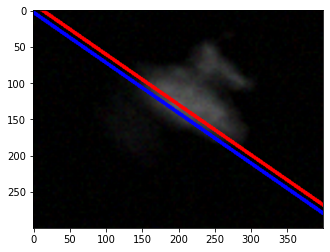

2.0
tensor([6.6982e-15, 2.7334e-07, 1.0000e+00])
tensor(2)
sigma:  0.0003043074203624152


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


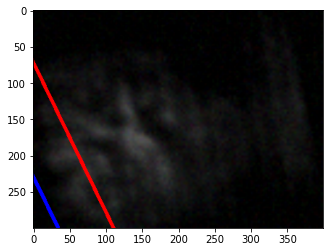

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([8.2811e-19, 3.0246e-08, 1.0000e+00])
tensor(2)
sigma:  0.002321788320299112


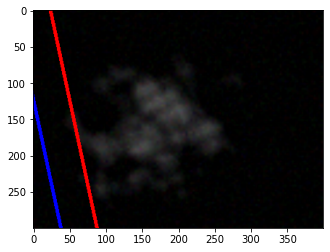

1.0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor([9.4547e-07, 9.9922e-01, 7.8367e-04])
tensor(1)
sigma:  0.0012015495987705155


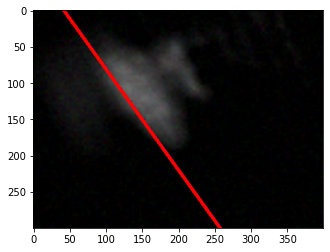

1.0
tensor([2.2351e-10, 1.0000e+00, 5.9109e-08])
tensor(1)
sigma:  0.00044359206161039


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


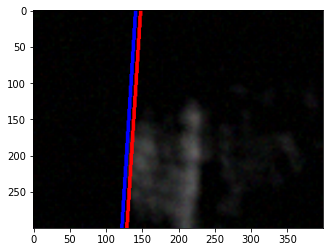

1.0
tensor([1.3606e-10, 1.0000e+00, 5.6602e-08])
tensor(1)
sigma:  1.3537369840124769e-05


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


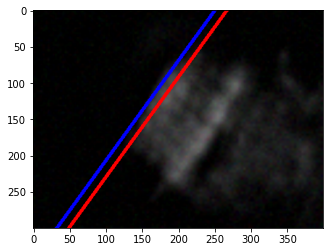

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([1.8679e-11, 1.0000e+00, 1.2923e-06])
tensor(1)
sigma:  0.0010399266359773507


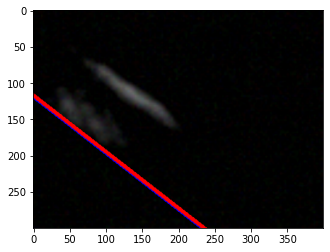

1.0
tensor([4.3483e-08, 1.0000e+00, 1.6439e-06])
tensor(1)
sigma:  0.0004890593664202414


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


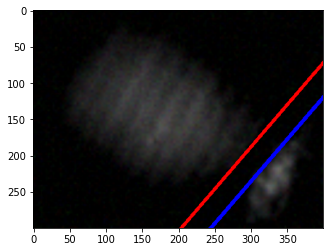

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


0.0
tensor([1.0000e+00, 1.6778e-24, 1.7066e-20])
tensor(0)
sigma:  1.3298351173066436


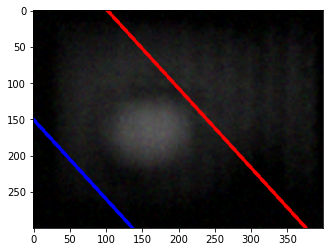

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([1.5295e-09, 1.0000e+00, 8.6673e-09])
tensor(1)
sigma:  0.0005545347760199798


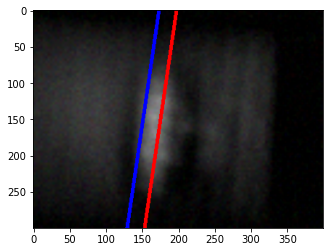

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([7.7377e-09, 1.0000e+00, 9.7082e-11])
tensor(1)
sigma:  0.001226947956196378


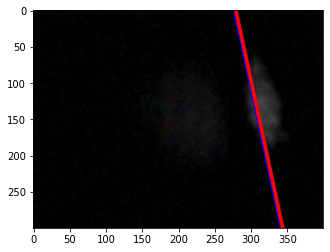

2.0
tensor([2.4055e-19, 2.3153e-11, 1.0000e+00])
tensor(2)
sigma:  0.0001411606703208279


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


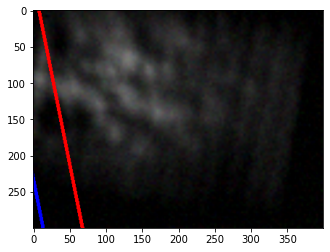

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([9.3665e-10, 1.0000e+00, 3.4084e-12])
tensor(1)
sigma:  0.0006938281950576997


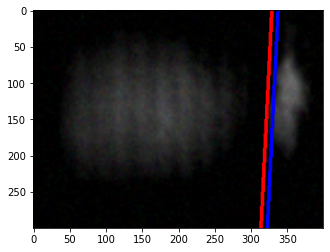

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([2.3147e-16, 2.2801e-06, 1.0000e+00])
tensor(2)
sigma:  0.002020472778352725


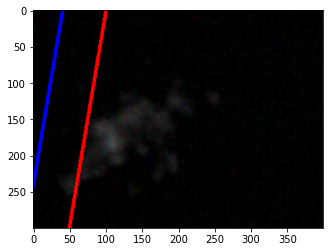

1.0
tensor([4.0363e-15, 1.0000e+00, 1.6666e-06])
tensor(1)
sigma:  0.00447557809646093


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


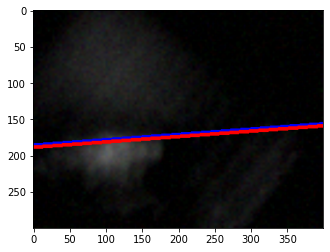

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([5.1737e-15, 4.6747e-05, 9.9995e-01])
tensor(2)
sigma:  0.0006538926075952411


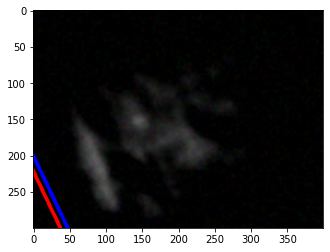

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([7.1981e-08, 1.0000e+00, 4.1847e-07])
tensor(1)
sigma:  0.001264647448497025


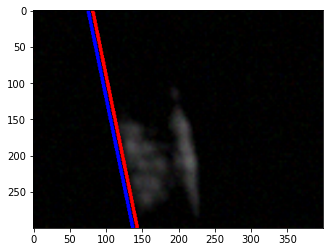

1.0
tensor([4.6576e-08, 1.0000e+00, 1.9821e-08])
tensor(1)
sigma:  0.0017975052842629374


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


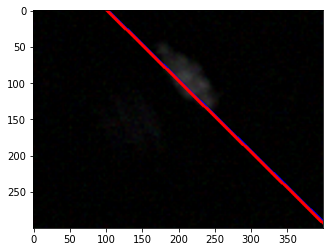

1.0
tensor([3.4337e-18, 9.9995e-01, 4.5774e-05])
tensor(1)
sigma:  0.0008012241490116256


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


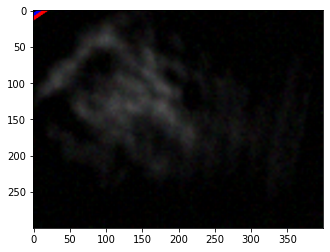

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([1.4081e-13, 1.9202e-04, 9.9981e-01])
tensor(2)
sigma:  0.0020348833907535835


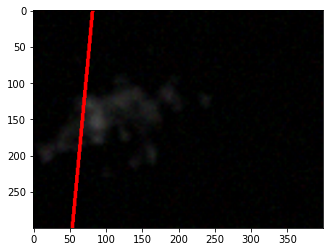

1.0
tensor([1.6683e-11, 1.0000e+00, 1.9338e-07])
tensor(1)
sigma:  8.876307241673098e-05


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


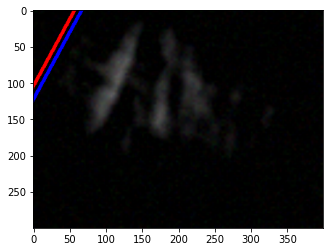

1.0
tensor([5.1408e-09, 1.0000e+00, 2.0846e-06])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(1)
sigma:  0.0003588094678343978


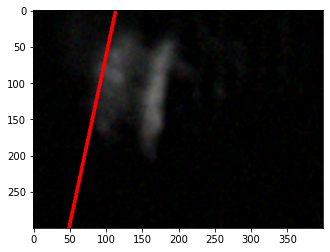

1.0
tensor([4.8158e-08, 9.9999e-01, 5.0442e-06])
tensor(1)
sigma:  0.0007545865781930505


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


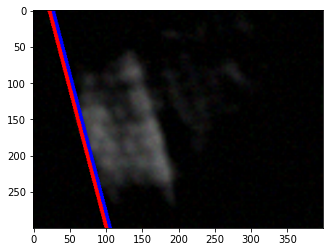

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([1.4163e-11, 1.0000e+00, 1.7755e-06])
tensor(1)
sigma:  0.0009066198216594601


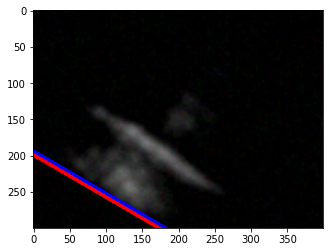

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([2.5256e-07, 1.0000e+00, 1.1008e-07])
tensor(1)
sigma:  0.0008724400767159413


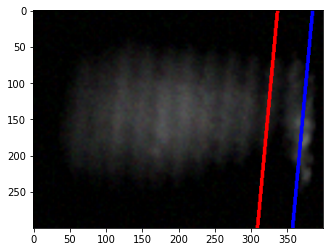

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([3.9796e-08, 1.0000e+00, 2.5504e-09])
tensor(1)
sigma:  0.00027229216524293776


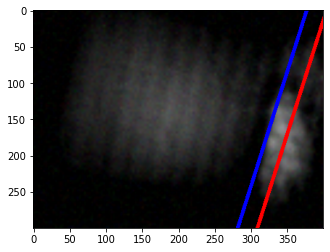

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([8.3240e-14, 1.8153e-02, 9.8185e-01])
tensor(2)
sigma:  0.0007042053113706093


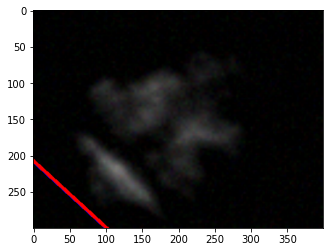

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([5.2649e-08, 9.9998e-01, 2.2672e-05])
tensor(1)
sigma:  0.0007899780344105545


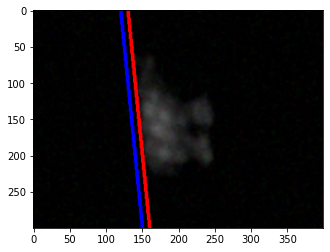

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([3.5126e-17, 1.0000e+00, 6.1591e-08])
tensor(1)
sigma:  0.0006653632700085593


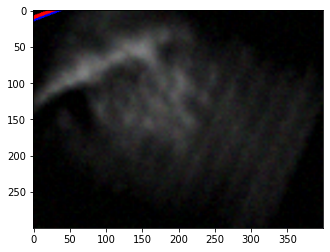

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([2.8910e-20, 8.5281e-09, 1.0000e+00])
tensor(2)
sigma:  0.004354852311161894


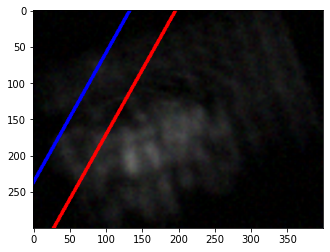

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([1.4532e-16, 1.0000e+00, 4.3154e-06])
tensor(1)
sigma:  0.000692087347631265


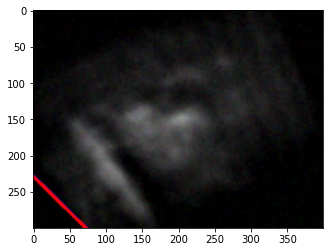

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([2.5290e-16, 1.4705e-06, 1.0000e+00])
tensor(2)
sigma:  2.2039124145667444e-06


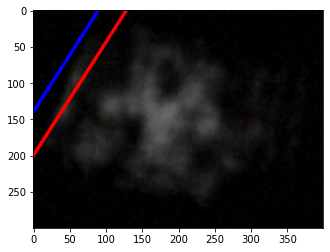

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([6.9706e-11, 1.0000e+00, 9.9911e-11])
tensor(1)
sigma:  0.011465360015556536


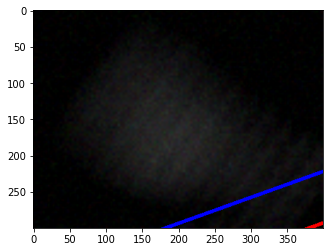

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


0.0
tensor([1.0000e+00, 2.6505e-24, 8.4025e-21])
tensor(0)
sigma:  1.2106615636764815


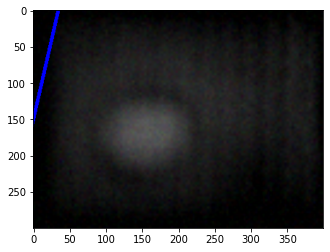

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([1.1048e-19, 3.0742e-07, 1.0000e+00])
tensor(2)
sigma:  0.011962339754038931


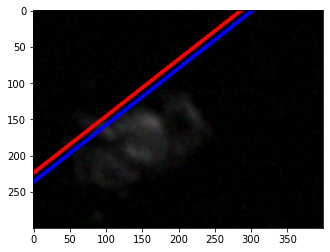

2.0
tensor([1.7591e-12, 6.0754e-04, 9.9939e-01])
tensor(2)
sigma:  0.0006575960437699285


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


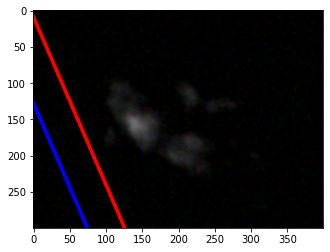

1.0
tensor([4.9386e-05, 9.9995e-01, 1.4055e-07])
tensor(1)
sigma:  0.004579121355077709


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


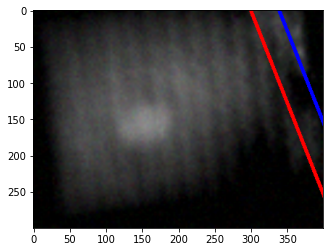

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([2.1007e-11, 9.9985e-01, 1.4885e-04])
tensor(1)
sigma:  0.00039066261931409996


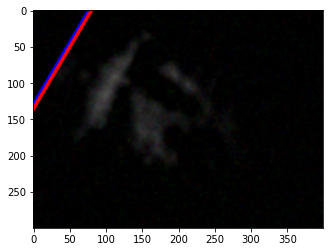

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([1.2270e-21, 2.1150e-10, 1.0000e+00])
tensor(2)
sigma:  0.0003285492998795214


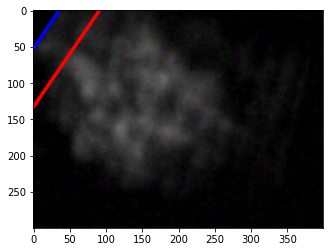

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([1.4793e-10, 9.9663e-01, 3.3736e-03])
tensor(1)
sigma:  2.3477874658284215e-06


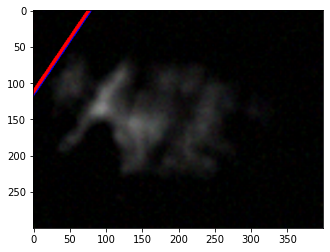

0.0
tensor([1.0000e+00, 1.9312e-24, 2.5063e-19])
tensor(0)
sigma:  1.2604611248398214


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


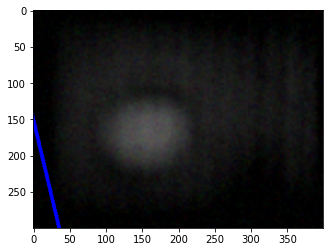

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([1.5708e-06, 9.9999e-01, 7.1001e-06])
tensor(1)
sigma:  0.000694377615656841


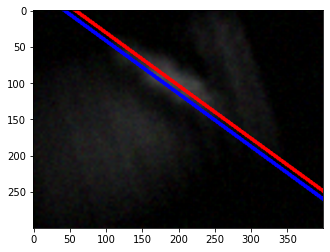

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([4.4609e-12, 1.0000e+00, 1.3588e-06])
tensor(1)
sigma:  0.00043040764970353473


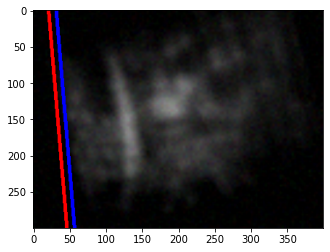

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([1.6645e-11, 1.0000e+00, 1.1104e-07])
tensor(1)
sigma:  0.0009677648743928874


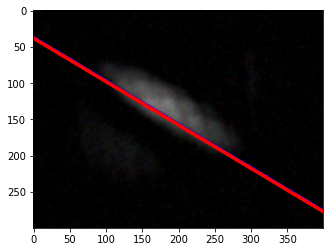

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([8.9678e-10, 1.0000e+00, 7.5687e-09])
tensor(1)
sigma:  0.00017432468573776172


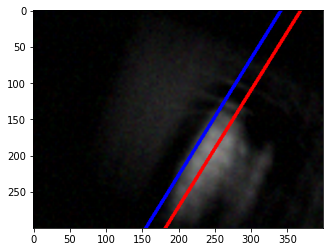

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([4.6330e-08, 1.0000e+00, 3.3867e-09])
tensor(1)
sigma:  0.0010543359167327626


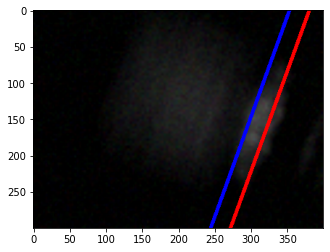

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([3.0181e-09, 1.0000e+00, 1.9993e-10])
tensor(1)
sigma:  0.0008744962866647499


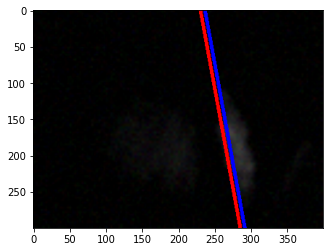

2.0
tensor([1.2114e-18, 8.8195e-08, 1.0000e+00])
tensor(2)
sigma:  0.0004508086440271897


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


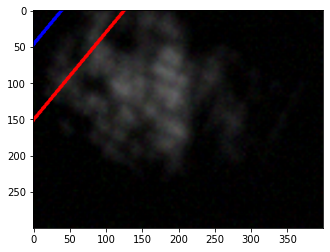

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([1.0293e-16, 7.1599e-09, 1.0000e+00])
tensor(2)
sigma:  0.000193109470074726


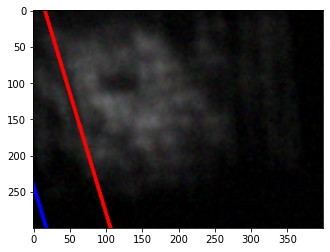

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([5.0850e-08, 1.0000e+00, 2.1806e-08])
tensor(1)
sigma:  0.0006441523660077331


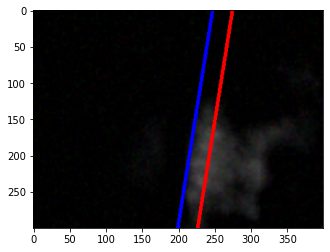

1.0
tensor([1.2801e-12, 9.9999e-01, 1.4779e-05])
tensor(1)
sigma:  0.0008583420280006276


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


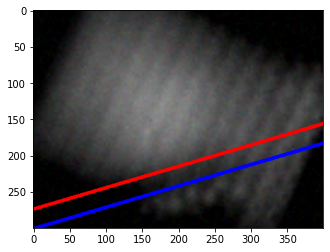

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([2.2298e-09, 1.0000e+00, 1.5004e-08])
tensor(1)
sigma:  0.0006825622848796176


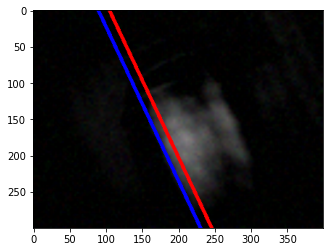

1.0
tensor([8.2285e-09, 1.0000e+00, 1.0380e-09])
tensor(1)
sigma:  0.0024252890602677463


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


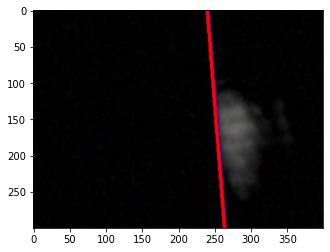

2.0
tensor([3.5333e-13, 1.1398e-03, 9.9886e-01])
tensor(2)
sigma:  0.00022146356174158888


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


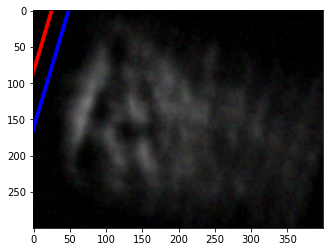

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([6.8468e-09, 9.9996e-01, 3.5107e-05])
tensor(1)
sigma:  0.001083981937765724


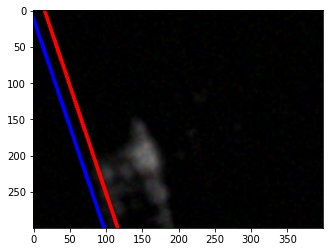

1.0
tensor([3.7662e-08, 9.9999e-01, 9.3656e-06])
tensor(1)
sigma:  0.0012325400164425876


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


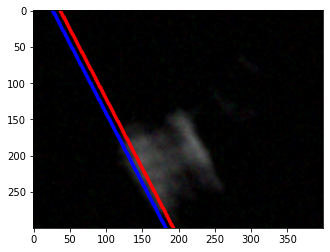

1.0
tensor([5.9894e-08, 1.0000e+00, 2.2040e-07])
tensor(1)
sigma:  0.000643910344706955


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


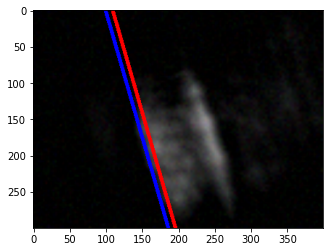

2.0
tensor([6.5339e-21, 3.0276e-11, 1.0000e+00])
tensor(2)
sigma:  0.0015430484276285489


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


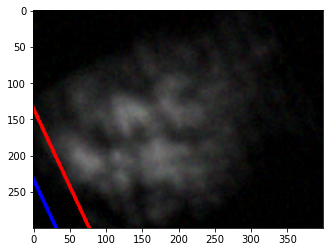

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


2.0
tensor([1.2335e-15, 2.2348e-05, 9.9998e-01])
tensor(2)
sigma:  0.0004234331082706433


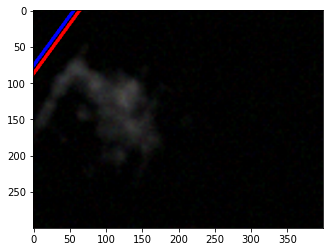

1.0
tensor([3.9302e-10, 9.9421e-01, 5.7914e-03])
tensor(1)
sigma:  0.005174994464498595


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


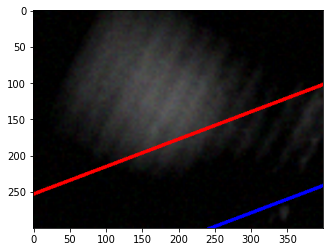

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([2.0180e-18, 1.0000e+00, 1.6611e-11])
tensor(1)
sigma:  0.024887148536587356


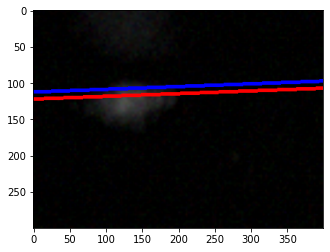

2.0
tensor([1.4189e-17, 6.4095e-06, 9.9999e-01])
tensor(2)
sigma:  0.009247207392959533


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


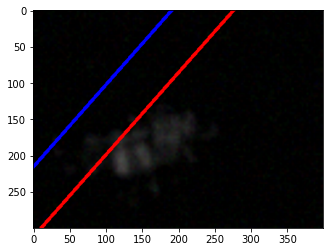

1.0
tensor([1.5910e-09, 1.0000e+00, 8.7493e-14])
tensor(1)
sigma:  0.0015509574376194046


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


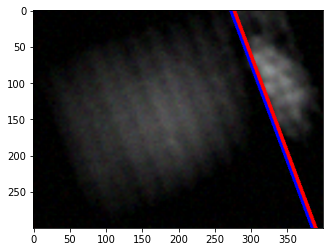

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([1.9558e-09, 1.0000e+00, 3.7346e-08])
tensor(1)
sigma:  0.00043051183736353416


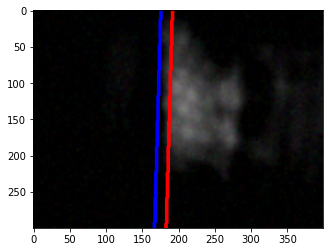

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([7.4814e-09, 9.9999e-01, 1.2068e-05])
tensor(1)
sigma:  0.000668883939904108


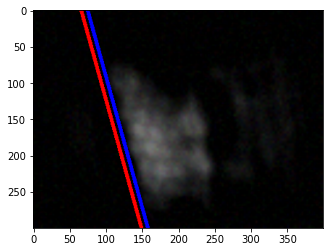

2.0
tensor([3.6091e-16, 1.6749e-05, 9.9998e-01])
tensor(2)
sigma:  0.0015452052890820855


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


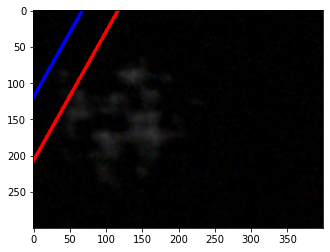

1.0
tensor([2.9366e-07, 1.0000e+00, 3.9355e-11])
tensor(1)
sigma:  0.002692013162787499


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


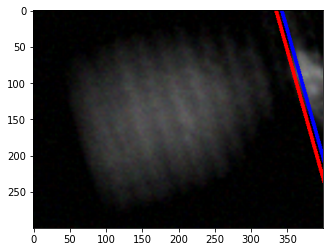

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([8.9251e-08, 1.0000e+00, 9.5082e-12])
tensor(1)
sigma:  0.0011549640267952827


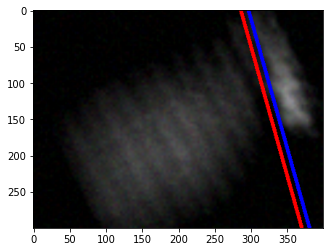

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([3.3365e-11, 1.0000e+00, 8.3414e-10])
tensor(1)
sigma:  0.0019302554978475328


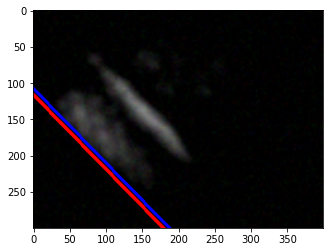

1.0
tensor([1.5967e-10, 1.0000e+00, 3.5568e-09])
tensor(1)
sigma:  0.0005210892505225773


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


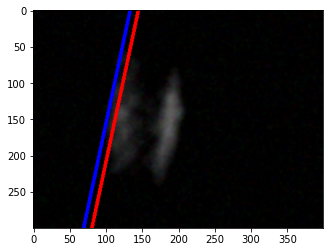

0.0
tensor([1.0000e+00, 3.6301e-20, 5.9458e-18])
tensor(0)
sigma:  0.9710910849371999


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


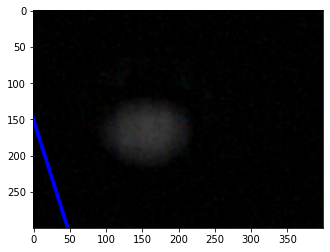

2.0
tensor([9.2305e-20, 2.2347e-07, 1.0000e+00])
tensor(2)
sigma:  0.0027473679867009437


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


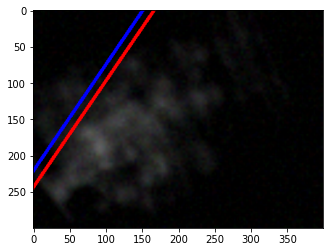

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([4.0066e-10, 1.0000e+00, 1.4749e-09])
tensor(1)
sigma:  0.000609583699917815


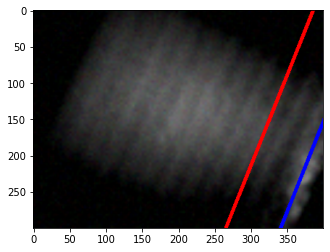

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([1.2372e-07, 1.0000e+00, 1.4597e-06])
tensor(1)
sigma:  0.0010312251979365805


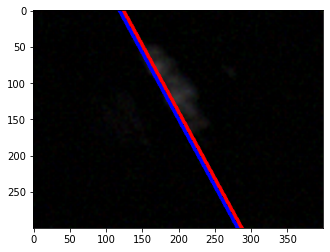

1.0
tensor([1.5401e-08, 1.0000e+00, 3.4360e-08])
tensor(1)
sigma:  0.0007765545630800674


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


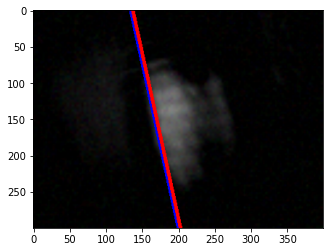

2.0
tensor([6.0209e-15, 1.4650e-06, 1.0000e+00])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


tensor(2)
sigma:  0.00042226458777107345


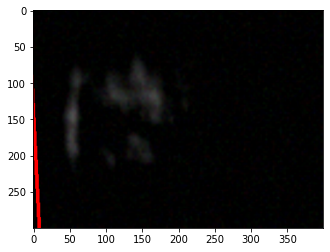

2.0
tensor([4.3448e-19, 2.0487e-09, 1.0000e+00])
tensor(2)
sigma:  0.0001355693371183353


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


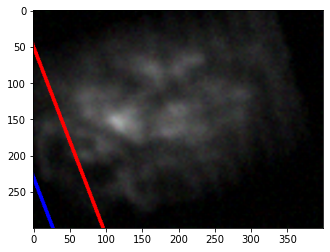

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([5.0371e-10, 1.0000e+00, 1.0989e-11])
tensor(1)
sigma:  0.001071573968581832


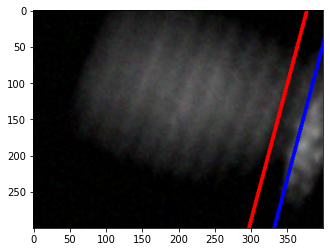

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([4.5847e-07, 1.0000e+00, 4.0758e-11])
tensor(1)
sigma:  0.00407699192186417


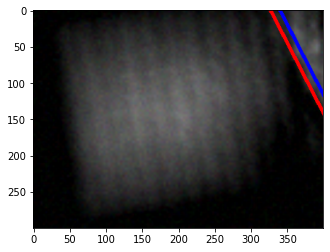

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


1.0
tensor([1.1625e-14, 1.0000e+00, 1.3367e-12])
tensor(1)
sigma:  0.00023494545189350902


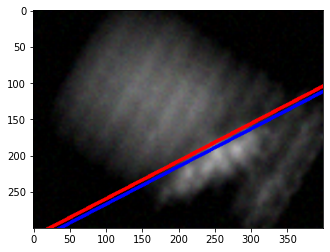

In [67]:
Y_pred = net.predict(X_test, device)
# Y_pred = Y_test
i = 2
print(Y_pred[i], Y_test[i])


def draw_line(img, theta, x0, y0, color=(0, 0, 1)):
    theta = theta / 180. * np.pi
    img = img.copy()
    rows, cols = img.shape[:2]
    
    center = np.array([x0 * cols, y0 * rows])
    
    d = 1100
    
    start_point = center + (d * np.sin(theta), d * np.cos(theta))
    end_point = center - (d * np.sin(theta), d * np.cos(theta))
    
    start_point = tuple(start_point.astype(np.int))
    end_point = tuple(end_point.astype(np.int))

#     color = (0, 0, 1)
    thickness = 4
    
    img = cv2.line(img, start_point, end_point, color, thickness) 
    return img


def imshow(im, vmin=0, vmax=1):
    plt.imshow(im[:,:,::-1], vmax=vmax, vmin=vmin)
    plt.show()
    
for i in range(50, 150):
    x, y = X_test[i], Y_pred[i]
    print(Y_test[i][-1])
    probs = torch.softmax(torch.from_numpy(y[5:]), dim=0)
    winner = probs.argmax(dim=0)
    print(probs)
    print(winner)
    print("sigma: ", y[4]**2)
    
    x = cv2.resize(x, (400, 300))
    theta = np.arctan2(y[2], y[3])
    theta_gt = np.arctan2(y[2], y[3])
    
#     x_int = y[0] - y[1]*np.tan(theta)
#     rendered_img_line = draw_line(x, theta / np.pi * 180., y[0], 0)
    rendered_img_linegt = draw_line(x, theta/np.pi*180., Y_test[i][0], Y_test[i][1], (1, 0, 0))
    rendered_img_line = draw_line(rendered_img_linegt, theta/np.pi*180., y[0], y[1], (0, 0, 1))
    
    imshow(rendered_img_line)

In [36]:
frames = dd.io.load("data/fabric_0319.h5")

In [627]:
len(frames)

856

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  0.00022115797948579763


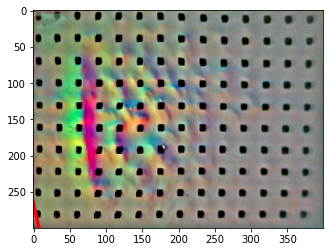

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0007536490922013805


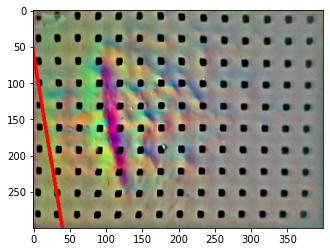

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0009181669117262065


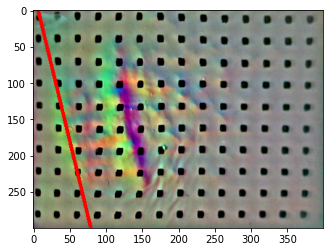

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0008066433816667079


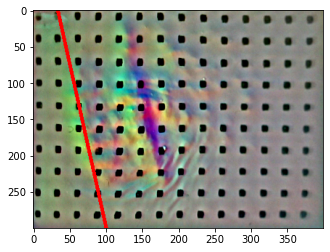

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0006915934992690609


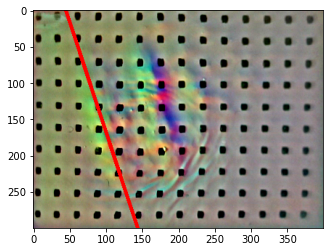

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0007401848786297571


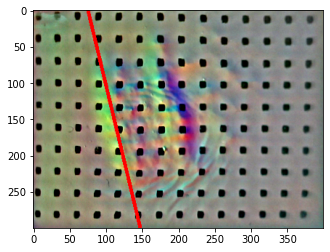

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0008445073406184722


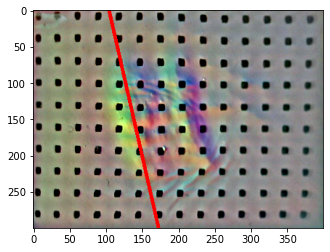

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0007237539559810102


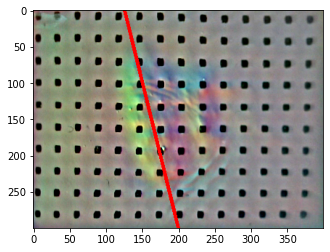

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0005655064465177745


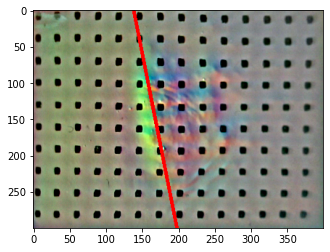

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0004979131387694569


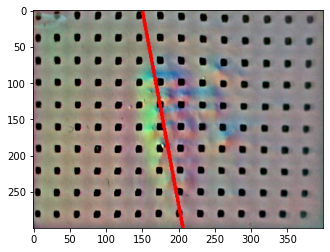

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.00042708938643477856


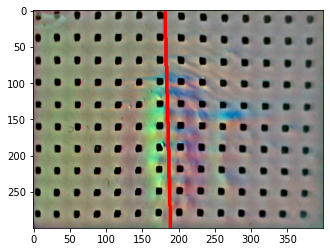

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.00036022824504934603


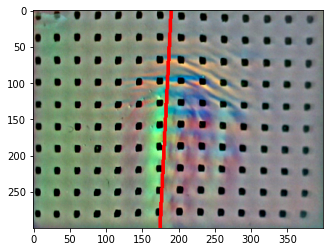

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0003247780109918441


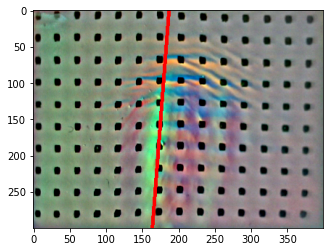

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0002499658110806241


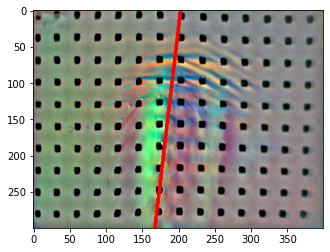

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.00026379546348570537


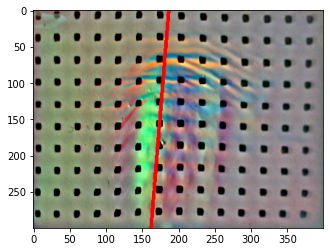

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.000273134860369742


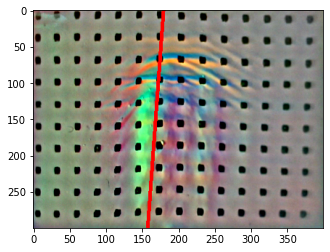

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0003340433052948649


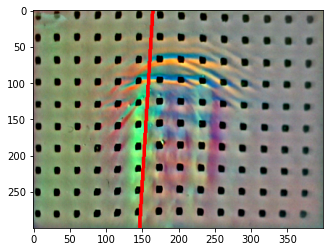

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.00017467841238473503


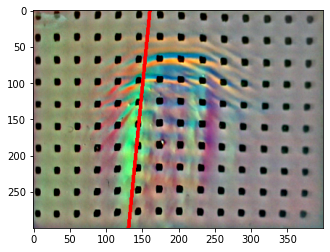

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0001724635713007544


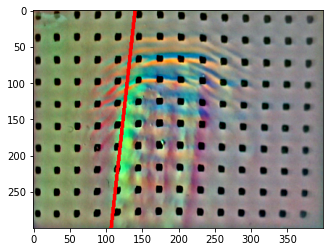

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.00011531233042227917


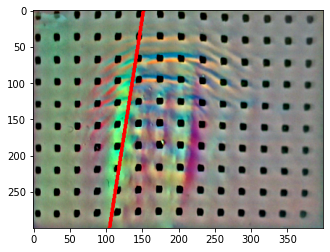

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  6.824736455973701e-05


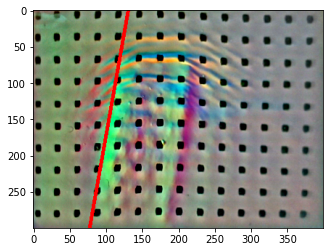

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  4.7400141338693746e-05


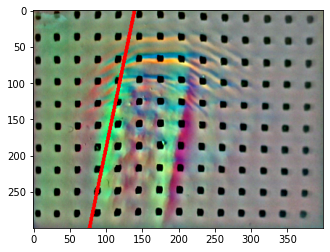

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.00011402813320793292


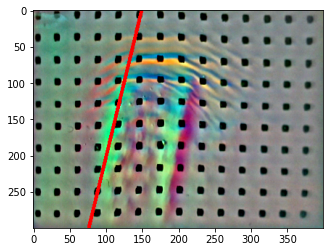

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  9.714574019970001e-05


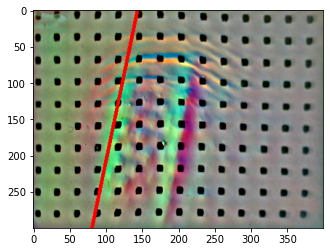

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0002573436621879921


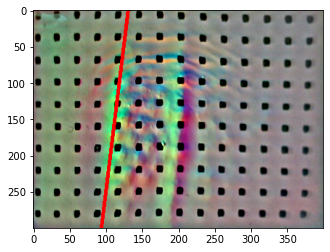

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.00099466767023082


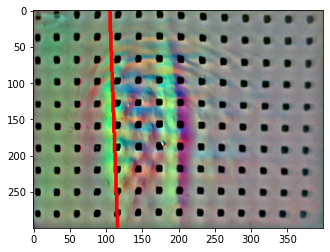

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0012234684637895676


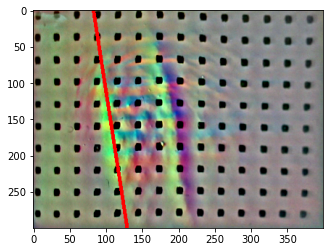

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0009983786242742654


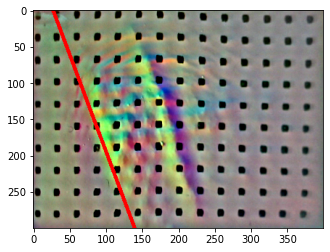

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0013070509805604424


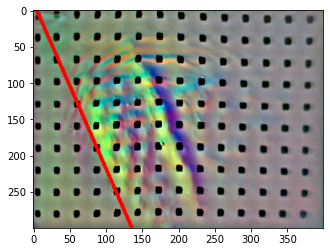

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0015476514749344222


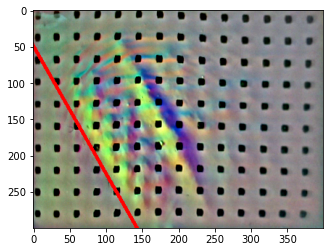

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0019955164615479554


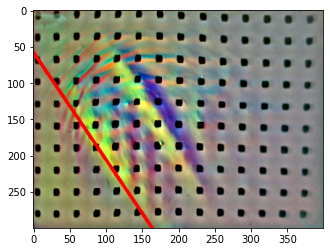

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0014587814065065846


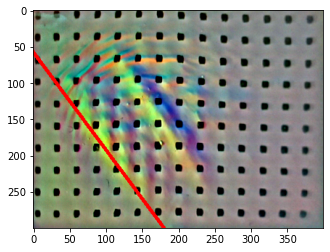

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0009510772313797156


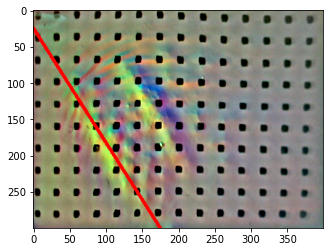

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0005512733996849845


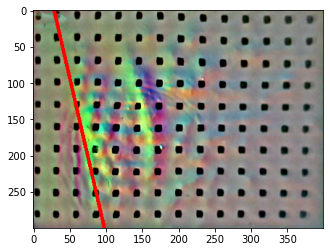

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  5.8653595715052464e-05


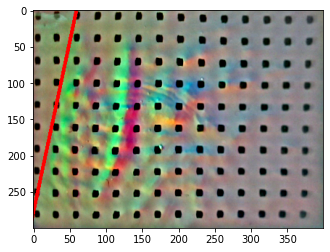

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  6.239168998446731e-05


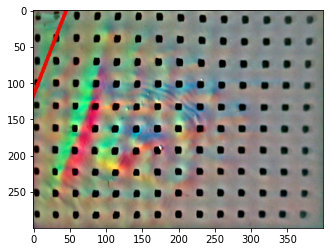

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  0.00026199488205626287


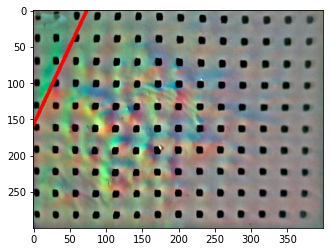

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  8.804524126472535e-05


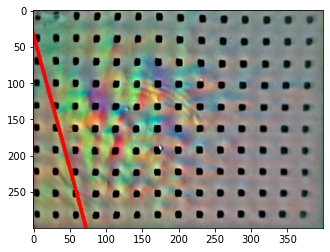

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  0.00024146751953281476


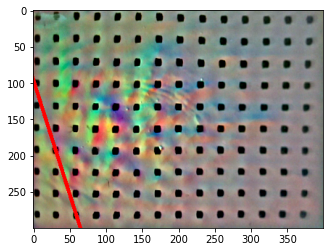

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  1.6462796481597763e-05


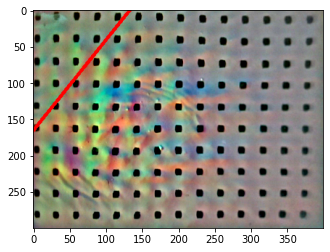

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  6.452980612797754e-05


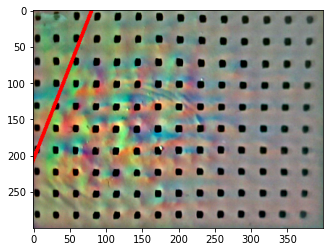

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  0.00018496717392248174


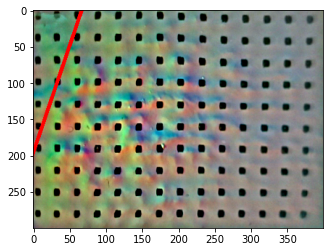

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  8.403417414015735e-05


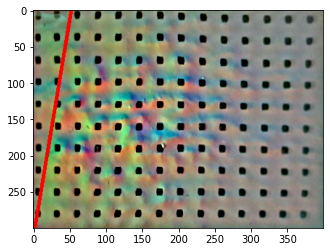

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  0.00094636012155426


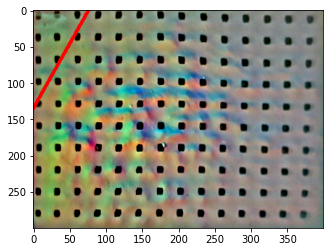

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  0.0027402088710779537


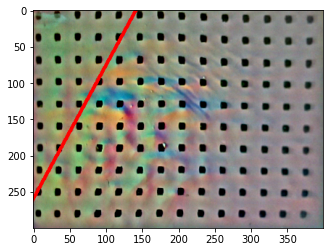

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  0.0038268811506703693


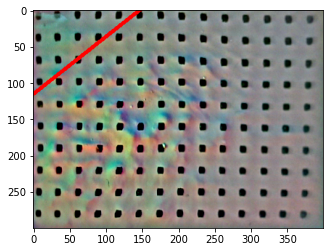

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  0.006373714883640469


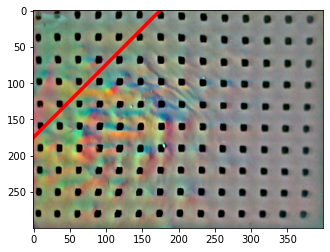

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  0.005311850594794443


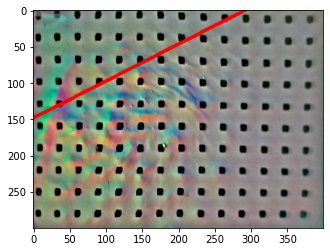

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  0.0018280429296881895


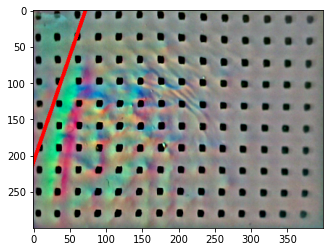

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(2)
sigma:  4.9742377528652626e-05


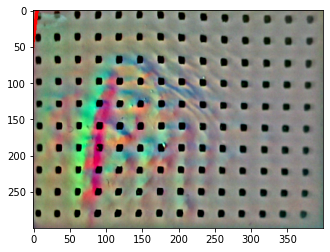

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.00016634739990412095


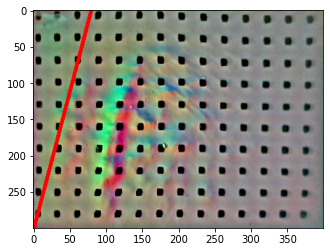

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  6.592309311050093e-05


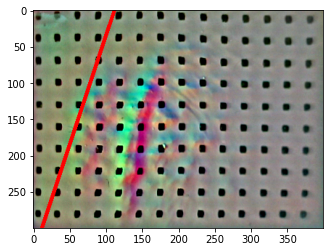

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  6.614832107677826e-05


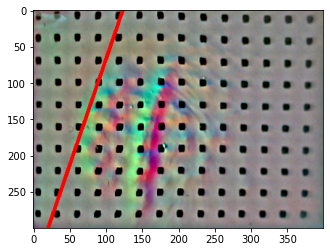

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0001902013013139886


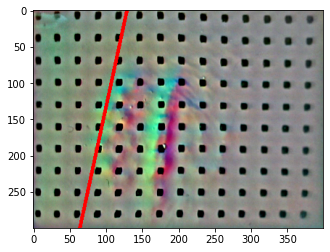

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


category:  tensor(1)
sigma:  0.0002318851625385948


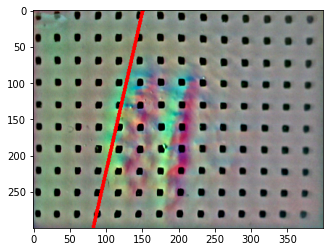

In [37]:
frame0 = frames[0]
# frame = frames[280]
frame = frames[460]
frame0_blur = cv2.GaussianBlur(frame0, (45, 45), 0)
# imgs = []

# for _ in range(150, 660, 3):
for _ in range(300, 850, 10):
# for _ in range(420, 1020):
    frame = frames[_]
    diff_magnified = (frame * 1.0 - frame0_blur) / 255. * 4 + 0.5
    diff = (frame * 1.0 - frame0_blur) / 255. + 0.5
    diff_small = cv2.resize(diff, (120, 90))
    depth, gx, gy = c3d.infer(diff_small * 255.0, demark=demark, display=False)
#     depth3 = np.dstack([depth / 30] * 3)
    depth3 = np.dstack([depth] * 3)
#     rendered_small = cv2.resize(frame/255., (120, 90))

#     Y_pred = net.predict([rendered_small], device)
    Y_pred = net.predict([depth3 * 120/400], device)
    i = 0
#     x = rendered_small
    x = diff_small
    y = Y_pred[i]
    
    probs = torch.softmax(torch.from_numpy(y[5:]), dim=0)
    winner = probs.argmax(dim=0)
    print("category: ", winner)
    print("sigma: ", y[4]**2)

#     x = cv2.resize(x, (400, 300))
    x = diff_magnified
#     x = cv2.resize(depth3 * 120/400, (400, 300))
    theta = np.arctan2(y[2], y[3])
    rendered_img_line = draw_line(x, theta/np.pi*180., y[0], y[1])
#     rendered_img_line = draw_line(x, theta / np.pi * 180., y[0], 0)
    
    plt.figure()
    imshow(rendered_img_line)

#     imgs.append(rendered_img_line)


In [ ]:
np.save("results/fabric_sg_depth.npy", imgs)

In [634]:
import time

frame0 = frames[0]

t0 = time.time()

for _ in range(50, 850):
    frame = frames[_]
    diff = (frame * 1.0 - frame0) / 255. + 0.5
    diff_small = cv2.resize(diff, (120, 90))
    depth, gx, gy = c3d.infer(diff_small * 255.0, demark=demark, display=False)
    depth3 = np.dstack([depth] * 3)
#     depth_small = cv2.resize(depth3, (120, 90))
    
#     rendered_small = cv2.resize(diff, (120, 90))
#     rendered_small = cv2.resize(frame/255., (120, 90))

    Y_pred = net.predict([depth3*120/400], device)
#     i = 0
#     x = rendered_small
#     y = Y_pred[i]
#     print(Y_pred[i])

#     x = cv2.resize(x, (400, 300))
#     theta = np.arctan2(y[2], y[3])
#     rendered_img_line = draw_line(x, theta/np.pi*180., y[0], y[1])
#     plt.figure()
#     imshow(rendered_img_line)

tf = time.time()

print((tf-t0)/800)

# depth takes .16s (6 Hz)
# downscaled depth takes .035s (29Hz)
# rendered image takes 0.0176s (56Hz)
# difference image takes .0184s (54 Hz)
# network with classifier takes .03s (33 Hz)

0.030339207351207733


In [ ]:
frame0 = frames[0]
frame = frames[600]
diff = (frame * 1.0 - frame0) / 255. * 4 + 0.5
diff_small = cv2.resize(diff, (120, 90))
depth, gx, gy = c3d.infer(diff_small * 255.0, demark=demark, display=False)
depth2 = np.dstack([depth / 10] * 3)
print(depth2.shape)
plt.imshow(depth2)
# plt.imshow(depth, cmap="gray", vmin=0)


In [155]:
net.load_state_dict(torch.load("models/edge_markers_depth.pth", map_location=device))

<All keys matched successfully>

In [90]:
gt1 = dd.io.load("data/fabric_groundtruth1.h5")
gt2 = dd.io.load("data/fabric_groundtruth2.h5")
gt3 = dd.io.load("data/fabric_groundtruth3.h5")
gt4 = dd.io.load("data/fabric_groundtruth4.h5")
gt5 = dd.io.load("data/fabric_groundtruth5.h5")

In [158]:
sum_theta_error = 0
sum_xy_error = 0
total = 0

frame0 = gt3[0]
frame0_blur = cv2.GaussianBlur(frame0, (45, 45), 0)

for _ in range(308, 630):
    frame = gt1[_]
    diff = (frame * 1.0 - frame0_blur) / 255. * 4 + 0.5
#     diff_small = cv2.resize(diff, (120, 90))
    depth, gx, gy = c3d.infer(diff * 255.0, demark=demark, display=False)
    depth3 = np.dstack([depth / 30] * 3)
    depth3_small = cv2.resize(depth3, (120, 90))
    Y_pred = net.predict([depth3_small], device)
    y = Y_pred[0]
    theta = np.arctan2(y[2], y[3])
    x = np.zeros(3)
    
    # interpolated labels
    lo = 308
    hi = 400
    if _ < 400:
        x[0] = (_-lo)*1.*(157-144)/(hi-lo) + 144
        x[1] = (_-lo)*1.*(180-175)/(hi-lo) + 175
        x[2] = (_-lo)*1.*(-2+3)/(hi-lo) - 3
    elif _ < 500:
        lo = 400
        hi = 500
        x[0] = (_-lo)*1.*(175-157)/(hi-lo) + 157
        x[1] = (_-lo)*1.*(184-180)/(hi-lo) + 180
        x[2] = (_-lo)*1.*(-4+2)/(hi-lo) - 2
    elif _ < 600:
        lo = 500
        hi = 600
        x[0] = (_-lo)*1.*(183-175)/(hi-lo) + 175
        x[1] = (_-lo)*1.*(190-184)/(hi-lo) + 184
        x[2] = (_-lo)*1.*(-2+4)/(hi-lo) - 4
    else:
        lo = 600
        hi = 630
        x[0] = (_-lo)*1.*(186-183)/(hi-lo) + 144
        x[1] = (_-lo)*1.*(190-190)/(hi-lo) + 175
        x[2] = (_-lo)*1.*(-3+2)/(hi-lo) - 2
    
    total += 1
#     print("theta: ", theta)
#     print("x, y: ", y[0]*400, y[1]*300)
#     sum_theta_error += min(np.abs(theta - x[2]), np.abs(theta - x[2]-180), np.abs(theta - x[2]+180))
#     sum_xy_error += np.sqrt((y[0]*400-x[0])**2 + (y[1]*300-x[1])**2)
    sum_xy_error += np.abs((y[0]*400 - y[1]*300*np.tan(theta))-(x[0] - y[1]*np.tan(theta*np.pi/180.)))
    sum_xy_error += np.abs((y[0]*400 + (1-y[1])*300*np.tan(theta))-(x[0] + (300-y[1])*np.tan(theta*np.pi/180.)))
# print(sum_theta_error/total)
print(sum_xy_error/total/2)

#new error metric: distance off on y = 0 and y = 300 slice

# downsampled network
# theta error: 2.64
# x,y error: 27.6
# slice distance: 18.0 pixels

# downsampled input to depth network
# theta error: 2.95
# x,y error: 19.4
# slice distance: 15.5 pixels

# 400x300 input to depth network
# slice distance: 17.5 pixels
    

17.543741720750827


In [ ]:
theta0 = -3
x0, y0 = (179 , 187)

# augment( 150 , 206.5 , 127.0 , -5.404 )
# 225 , 287.0 , 165.5 , 19.911

frame = gt1[550]
rows, cols = frame.shape[:2]

diff = (frame * 1.0 - frame0_blur) / 255. * 1.0 + 0.5
diff_magnified = (diff - 0.5) * 4 + 0.5

# x = cv2.resize(frame, (400, 300)) / 255.
x = cv2.resize(diff_magnified, (400, 300))
# theta: in degrees
# x0: 0-1 (=>(0, cols))
# y0: 0-1 (=>(0, rows))
rendered_img_line = draw_line(x , theta0, x0 / cols, y0 / rows)
imshow(rendered_img_line)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.38280144  0.6069721  -0.11687976  0.9608073 ]


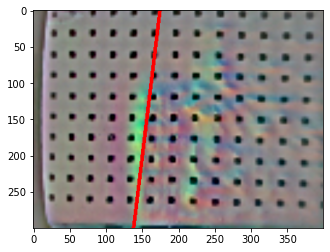

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.38993192  0.58262694 -0.19593298  0.9211087 ]


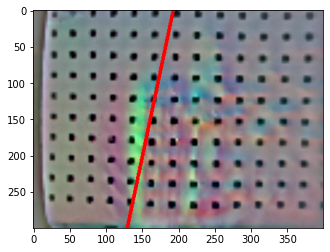

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.38577786  0.54114276 -0.07857265  0.98981833]


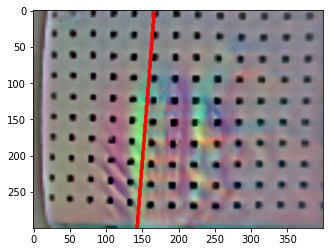

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.38428554  0.5409559  -0.0741008   1.001665  ]


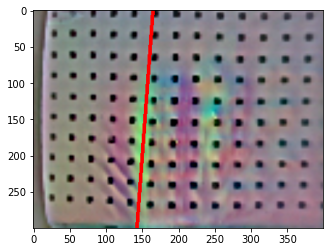

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.4124984  0.5118527 -0.1315355  1.0229918]


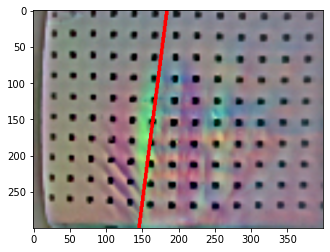

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.42061853  0.5134006  -0.10233923  1.0118659 ]


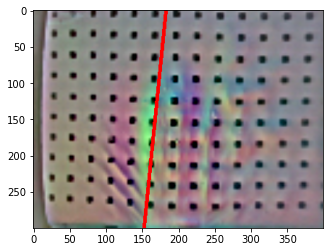

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.4275295   0.56250995 -0.04296184  1.0092454 ]


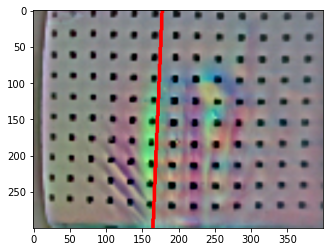

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.46909136  0.5337347  -0.05195249  0.968804  ]


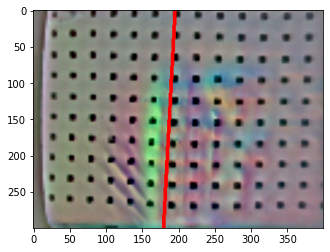

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.44347632  0.54660296 -0.0044944   1.0007352 ]


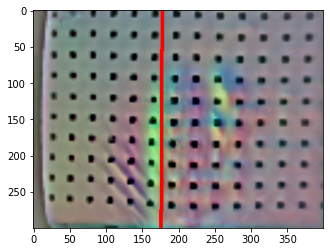

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.44308168  0.58079815 -0.00272046  0.9858583 ]


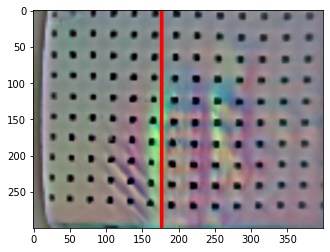

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.4530974   0.55843055 -0.00912806  0.97864354]


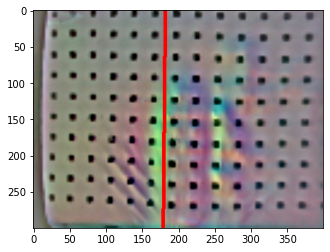

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.44268602  0.5591005  -0.03326003  1.0045288 ]


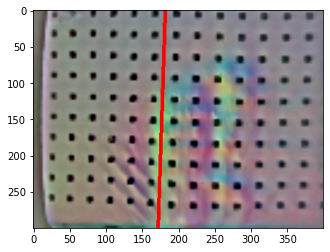

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.44563383  0.5982787  -0.04472212  1.0117211 ]


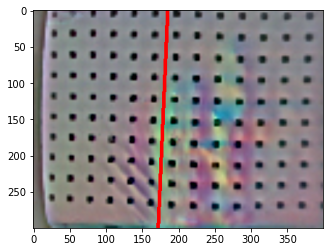

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.44760916  0.60815823 -0.03215832  0.9923972 ]


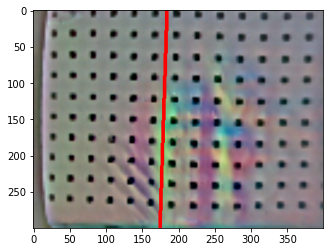

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.46780115  0.56897473 -0.11295242  0.9871731 ]


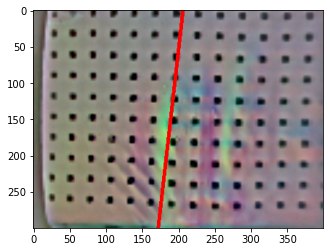

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.47212082  0.61812496 -0.03014159  0.99612784]


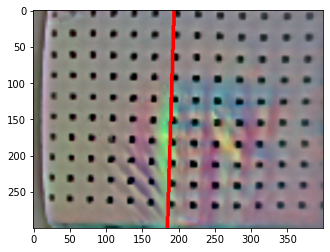

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[ 0.4794524   0.60198474 -0.09681144  1.0019214 ]


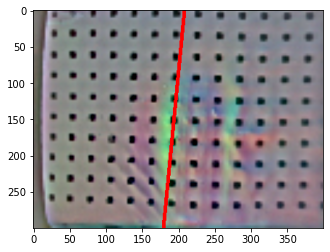

In [140]:
frame0 = gt3[0]
frame0_blur = cv2.GaussianBlur(frame0, (45, 45), 0)
# imgs = []

for _ in range(308, 630, 20):
    frame =gt1[_]
    diff = (frame * 1.0 - frame0_blur) / 255. * 3 + 0.5
    diff_small = cv2.resize(diff, (120, 90))
    depth, gx, gy = c3d.infer(diff_small * 255.0, demark=demark, display=False)
    depth3 = np.dstack([depth / 30] * 3)
#     rendered_small = cv2.resize(frame/255., (120, 90))

#     Y_pred = net.predict([rendered_small], device)
    Y_pred = net.predict([depth3], device)
    i = 0
#     x = rendered_small
    x = diff_small
    y = Y_pred[i]
    print(Y_pred[i])

    x = cv2.resize(x, (400, 300))
    theta = np.arctan2(y[2], y[3])
    rendered_img_line = draw_line(x, theta/np.pi*180., y[0], y[1])
    plt.figure()
    imshow(rendered_img_line)

#     imgs.append(rendered_img_line)
